In [ ]:
import torch
import torchvision.transforms as transforms
import torch.nn.functional as F
import torch.nn as nn

from PIL import Image

import matplotlib.pyplot as plt

from skimage import data
from skimage import filters
from skimage import exposure
from skimage.segmentation import slic, mark_boundaries

import cv2

import numpy as np

from google.colab.patches import cv2_imshow

Função que aplica:

1.   Filtro da mediana, com kernel 21x21
2.   Segmentação de Otsu
3.   Erosão binária, com kernel 29x29
4.   Dilatação binária, com kernel 21x21



In [ ]:
def image_treatment(img):
    image = cv2.imread(img + '.jpg', cv2.IMREAD_GRAYSCALE)

    #Aplicando filtro da mediana (sal e pimenta)
    image = cv2.medianBlur(image, ksize=21)

    #Aplicando segmentação de otsu
    val = filters.threshold_otsu(image)
    otsu_img = image > val

    image_aux = otsu_img.astype('uint8') * 255

    #Aplicando erosão, com kernel tamanho 29
    kernel = np.ones((29, 29), dtype=np.uint8)
    eroded_image = cv2.erode(image_aux, kernel, iterations=1)

    #Aplicando dilatação, com kernel tamanho 21
    kernel = np.ones((21, 21), dtype=np.uint8)
    dilated_image = cv2.dilate(image_aux, kernel, iterations=1)

    image_resized = cv2.resize(dilated_image, (2112, 2000), interpolation=cv2.INTER_AREA)

    #Salvando imagem
    cv2.imwrite(img + "_treated.jpg", image_resized)

# Aqui aplicamos OTSU, Erosão e Dilatação nas imagens

In [ ]:
image_treatment('Normal')
image_treatment('21h')
image_treatment('29h')
image_treatment('44h')
image_treatment('53h')
image_treatment('73h')
image_treatment('96h')

In [ ]:
import cv2
import numpy as np
import warnings

warnings.filterwarnings("ignore")

def hoshen_kopelman(image):
    """
    Função para rotular regiões conectadas em uma imagem binária usando o algoritmo de Hoshen-Kopelman.

    Parâmetros:
        - image: array numpy representando a imagem binária.

    Retorna:
        - labeled_image: uma cópia da imagem original com rótulos atribuídos a cada região conectada.
        - num_labels: o número total de regiões conectadas na imagem.
    """
    labeled_image = np.zeros_like(image)
    id_equivalences = {}

    current_label = 1  # Rótulo atual

    # Percorre a imagem e rotula as regiões conectadas
    for i in range(image.shape[0]):
        for j in range(image.shape[1]):
            # Se o pixel atual for branco
            if image[i, j] == 255:
                neighbors = []

                # Verifica os pixels vizinhos
                if i > 0 and labeled_image[i-1, j] != 0:
                    neighbors.append(labeled_image[i-1, j])
                if j > 0 and labeled_image[i, j-1] != 0:
                    neighbors.append(labeled_image[i, j-1])

                if len(neighbors) == 0:
                    # Se nenhum vizinho foi rotulado, atribui um novo rótulo
                    labeled_image[i, j] = current_label
                    current_label += 1
                else:
                    # Encontra o menor rótulo dos vizinhos e atribui ao pixel atual
                    min_label = min(neighbors)
                    labeled_image[i, j] = min_label

                    # Atualiza a tabela de equivalência de rótulos
                    for neighbor in neighbors:
                        if neighbor != min_label:
                            id_equivalences[neighbor] = min_label

    # Resolve equivalências de rótulos
    for i in range(labeled_image.shape[0]):
        for j in range(labeled_image.shape[1]):
            if labeled_image[i, j] in id_equivalences:
                labeled_image[i, j] = id_equivalences[labeled_image[i, j]]

    # Calcula o número total de regiões conectadas
    num_labels = len(np.unique(labeled_image)) - 1  # Ignora o rótulo 0

    return labeled_image, num_labels

# Carregar a imagem binária em escala de cinza
image = cv2.imread('96h_o_f_er_d.png', cv2.IMREAD_GRAYSCALE)

# Aplicar o algoritmo de Hoshen-Kopelman
labeled_image, num_labels = hoshen_kopelman(image)

# Exibir a imagem rotulada e o número de regiões conectadas
print("Imagem Rotulada:\n", labeled_image)
print("Número de Regiões Conectadas:", num_labels)


Imagem Rotulada:
 [[1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 ...
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]
 [1 1 1 ... 1 1 1]]
Número de Regiões Conectadas: 61


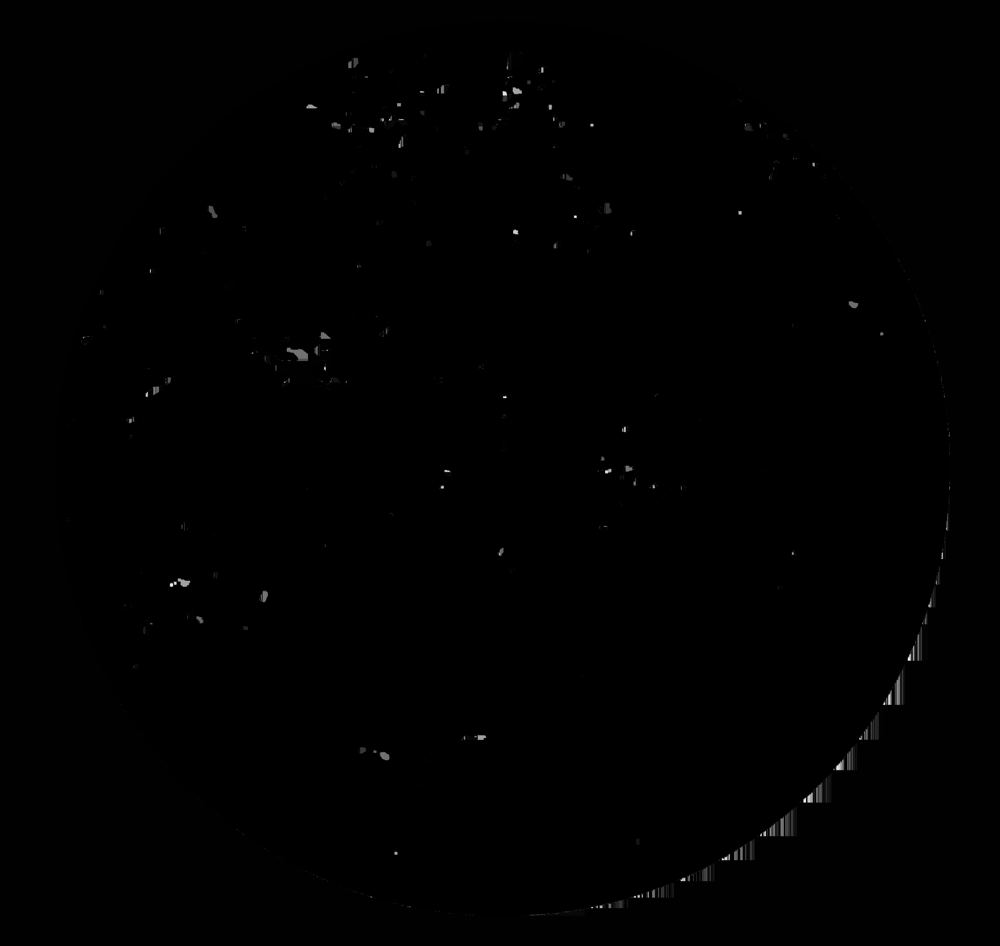

In [ ]:
cv2_imshow(labeled_image)

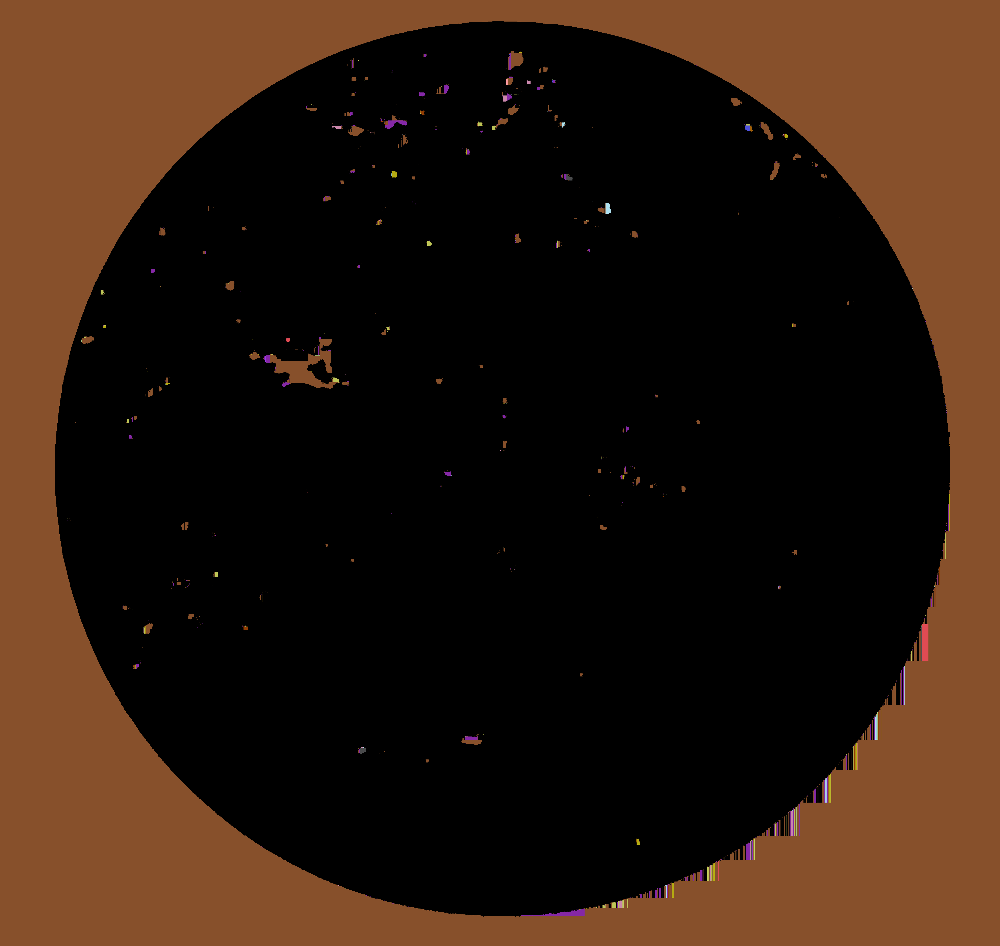

In [ ]:
label_colors = np.random.randint(0, 255, size=(num_labels+1, 3), dtype=np.uint8)

# Verificar se há mais rótulos do que cores disponíveis
if num_labels > len(label_colors):
    print("Número de rótulos excede o número de cores disponíveis.")

# Mapear rótulos para cores de forma mais inteligente
colored_image = np.zeros((image.shape[0], image.shape[1], 3), dtype=np.uint8)
for label in range(1, num_labels+1):
    if label < len(label_colors):
        colored_image[labeled_image == label] = label_colors[label]

# Exibir a imagem rotulada
cv2_imshow(colored_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

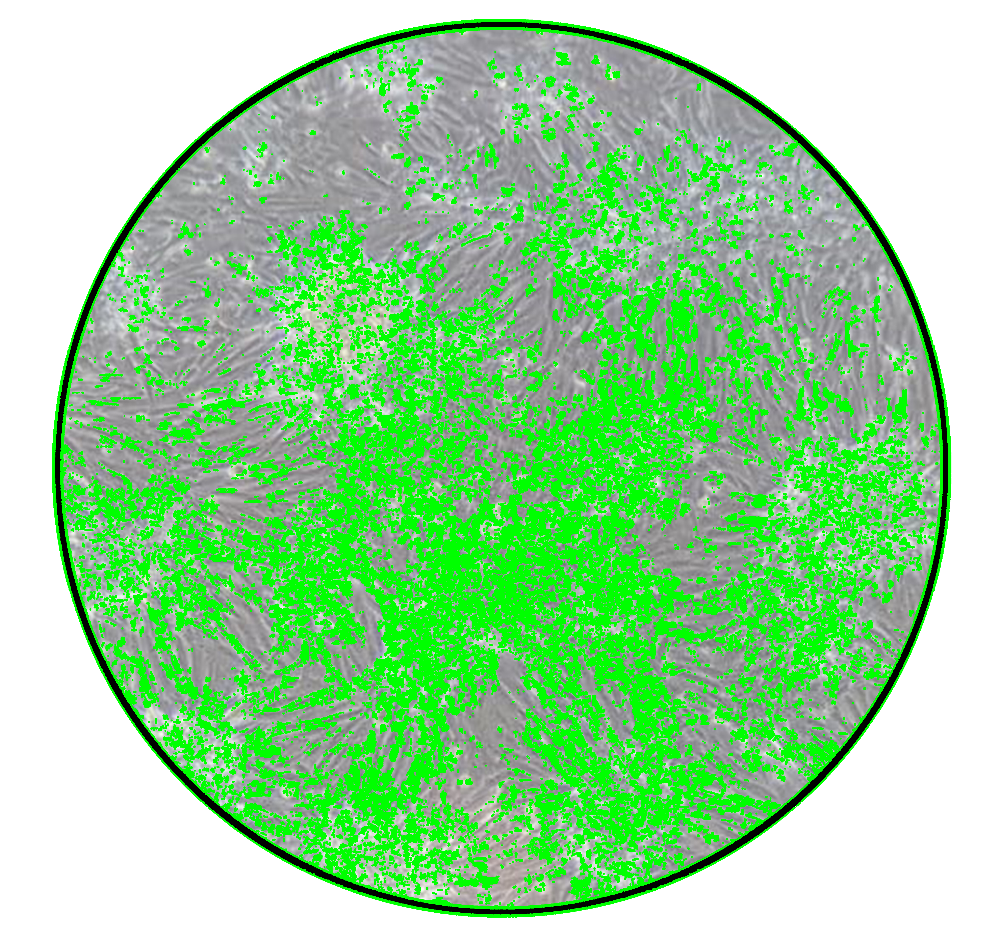

In [ ]:
import cv2
import numpy as np
from scipy.ndimage import maximum_filter
from scipy.ndimage import gaussian_laplace

# Carregar a imagem
image = cv2.imread('73h.jpg')

# Converter para escala de cinza
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Aplicar filtro Gaussiano para suavização
blurred = cv2.GaussianBlur(gray, (0, 0), 1.0)

# Aplicar filtro Laplaciano do Gaussiano (LoG)
log = gaussian_laplace(blurred, sigma=1)

# Encontrar picos na imagem LoG
peaks = np.where((log == maximum_filter(log, footprint=np.ones((3, 3)))) & (log > 0))

# Desenhar os núcleos na imagem original
for y, x in zip(*peaks):
    cv2.circle(image, (x, y), 5, (0, 255, 0), -1)  # Desenhar um círculo verde nos picos

# Exibir a imagem com os núcleos identificados
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
import cv2
import numpy as np
from skimage import measure, morphology
import matplotlib.pyplot as plt

# Função para processar uma imagem e extrair características
def process_image(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    _, binary_image = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    binary_image = morphology.remove_small_objects(binary_image > 0, min_size=30)
    binary_image = binary_image.astype(np.uint8)
    labeled_image = measure.label(binary_image)
    properties = measure.regionprops_table(labeled_image, properties=('area', 'perimeter', 'centroid', 'area_filled'))

    return labeled_image, properties

In [ ]:
# Lista de nomes de arquivos tratados
nomes_tratados = ['Normal_treated', '21h_treated', '29h_treated', '44h_treated', '53h_treated', '73h_treated', '96h_treated']

# Dicionários para armazenar áreas e perímetros de cada imagem
areas_dict = {}
perimeters_dict = {}

# Iterar sobre cada imagem tratada
for nome in nomes_tratados:
    # Aplicar a função process_image
    _, properties = process_image(f"{nome}.jpg")

    # Armazenar áreas e perímetros da imagem atual
    areas_dict[nome] = properties['area']
    perimeters_dict[nome] = properties['perimeter']

# Criar DataFrame para as áreas e perímetros
df_areas = pd.DataFrame(areas_dict)
df_perimeters = pd.DataFrame(perimeters_dict)

# Calcular medidas estatísticas da área e do perímetro para cada imagem
area_stats = df_areas.describe()
perimeter_stats = df_perimeters.describe()

print("Medidas estatísticas da área:")
print(area_stats)
print("\nMedidas estatísticas do perímetro:")
print(perimeter_stats)

ValueError: All arrays must be of the same length

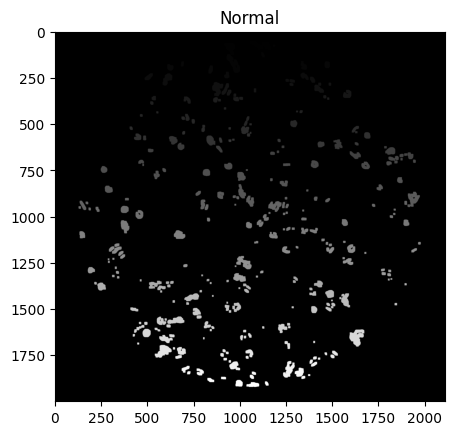

count    2.910000e+02
mean     5.664540e+03
std      8.447318e+04
min      8.100000e+01
25%      2.030000e+02
50%      3.820000e+02
75%      1.039000e+03
max      1.441661e+06
Name: area, dtype: float64


In [ ]:
# Exemplo de uso para uma imagem de controle
labeled_image, properties = process_image('Normal_treated.jpg')

# Exibir imagem segmentada
plt.imshow(labeled_image, cmap='gray')
plt.title('Normal')
plt.show()

# Imprimir propriedades
import pandas as pd
df = pd.DataFrame(properties)
print(df['area'].describe())
df.to_csv('Normal.csv', sep=';', decimal=',')
#print(df)

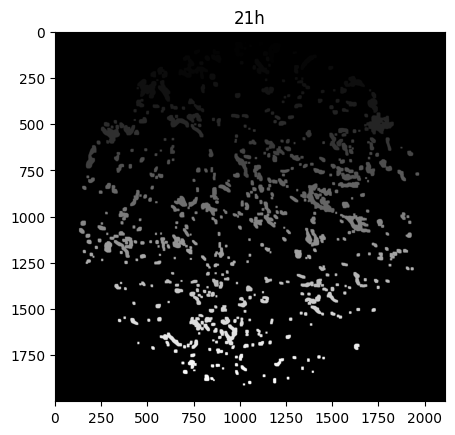

count    4.810000e+02
mean     3.812738e+03
std      6.570648e+04
min      9.900000e+01
25%      2.480000e+02
50%      4.340000e+02
75%      8.490000e+02
max      1.441636e+06
Name: area, dtype: float64


In [ ]:
# Exemplo de uso para uma imagem de controle
labeled_image, properties = process_image('21h_treated.jpg')

# Exibir imagem segmentada
plt.imshow(labeled_image, cmap='gray')
plt.title('21h')
plt.show()

# Imprimir propriedades
import pandas as pd
df = pd.DataFrame(properties)
print(df['area'].describe())
df.to_csv('21h.csv', sep=';', decimal=',')
#print(df)

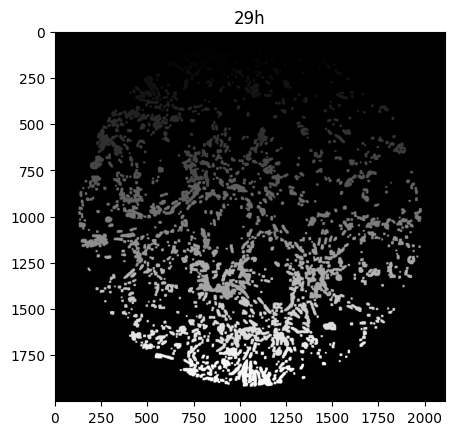

count    8.590000e+02
mean     2.425588e+03
std      4.919381e+04
min      8.000000e+01
25%      1.705000e+02
50%      2.960000e+02
75%      6.600000e+02
max      1.441738e+06
Name: area, dtype: float64
        area     perimeter   centroid-0   centroid-1  area_filled
0    1441738  14465.068827  1019.214443  1048.540727      4224000
1        642    106.870058    71.682243  1130.433022          642
2        323     64.384776    69.433437   955.575851          323
3        117     40.000000    67.000000   990.000000          117
4        218     54.485281    78.729358   904.724771          218
..       ...           ...          ...          ...          ...
854     3009    495.793939  1884.553340   869.388501         3031
855      576    109.597980  1872.875000  1185.661458          576
856      279     61.313708  1872.476703  1341.939068          279
857       90     34.000000  1877.000000   924.500000           90
858      287     61.213203  1884.156794   947.595819          287

[859

In [ ]:
# Exemplo de uso para uma imagem de controle
labeled_image, properties = process_image('29h_treated.jpg')

# Exibir imagem segmentada
plt.imshow(labeled_image, cmap='gray')
plt.title('29h')
plt.show()

# Imprimir propriedades
import pandas as pd
df = pd.DataFrame(properties)
print(df['area'].describe())
df.to_csv('29h.csv', sep=';', decimal=',')
print(df)

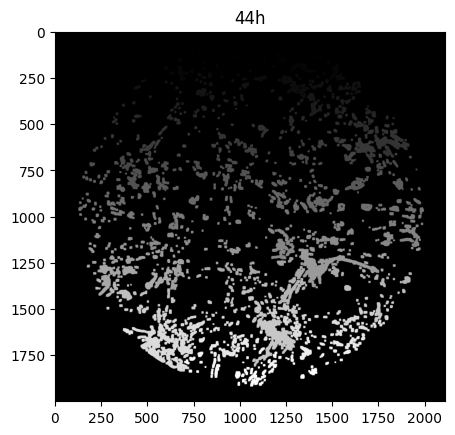

count    7.460000e+02
mean     2.722731e+03
std      5.280094e+04
min      8.000000e+01
25%      1.960000e+02
50%      3.250000e+02
75%      6.595000e+02
max      1.441693e+06
Name: area, dtype: float64
        area     perimeter   centroid-0   centroid-1  area_filled
0    1441693  14464.483041  1019.210892  1048.543338      4224000
1        320     65.313708    74.587500  1206.843750          320
2        401     73.455844   105.443890  1277.289277          401
3        501     84.627417   113.145709   779.175649          501
4        510     98.727922   114.135294   937.358824          510
..       ...           ...          ...          ...          ...
741      528     83.455844  1867.549242  1336.738636          528
742      199     52.242641  1866.316583   845.798995          199
743      590    122.970563  1892.815254  1023.688136          590
744      591    126.426407  1900.367174  1118.417936          591
745      297     65.656854  1906.696970   992.639731          297

[746

In [ ]:
# Exemplo de uso para uma imagem de controle
labeled_image, properties = process_image('44h_treated.jpg')

# Exibir imagem segmentada
plt.imshow(labeled_image, cmap='gray')
plt.title('44h')
plt.show()

# Imprimir propriedades
import pandas as pd
df = pd.DataFrame(properties)
print(df['area'].describe())
df.to_csv('44h.csv', sep=';', decimal=',')
print(df)

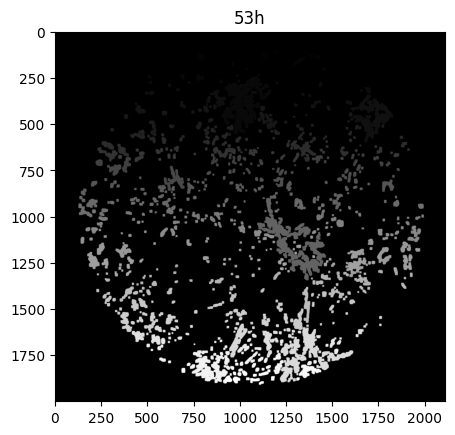

count    6.160000e+02
mean     3.210903e+03
std      5.813370e+04
min      8.100000e+01
25%      2.010000e+02
50%      3.230000e+02
75%      6.655000e+02
max      1.441691e+06
Name: area, dtype: float64
        area     perimeter   centroid-0   centroid-1  area_filled
0    1441691  14464.483041  1019.210952  1048.543354      4224000
1        705    103.355339    77.784397  1126.608511          705
2       1000    142.083261    93.801000  1045.016000         1000
3        231     55.071068    98.090909   804.350649          231
4        263     57.556349    98.992395   959.942966          263
..       ...           ...          ...          ...          ...
611     1057    131.497475  1884.550615   979.128666         1057
612      298     62.727922  1879.634228  1041.295302          298
613      303     64.142136  1880.290429  1311.716172          303
614      963    151.698485  1886.383178  1076.859813          963
615      387     79.798990  1901.609819  1114.005168          387

[616

In [ ]:
# Exemplo de uso para uma imagem de controle
labeled_image, properties = process_image('53h_treated.jpg')

# Exibir imagem segmentada
plt.imshow(labeled_image, cmap='gray')
plt.title('53h')
plt.show()

# Imprimir propriedades
import pandas as pd
df = pd.DataFrame(properties)
print(df['area'].describe())
df.to_csv('53h.csv', sep=';', decimal=',')
print(df)

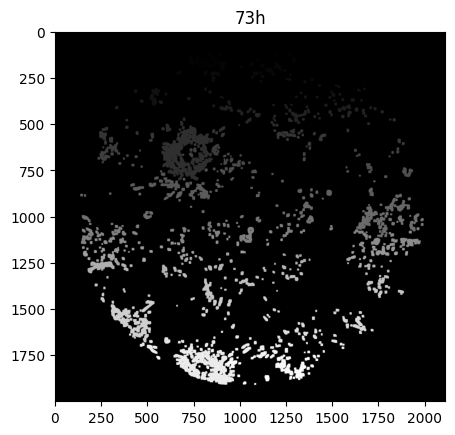

count    5.470000e+02
mean     3.322658e+03
std      6.166656e+04
min      8.000000e+01
25%      1.900000e+02
50%      2.800000e+02
75%      4.830000e+02
max      1.441738e+06
Name: area, dtype: float64
        area     perimeter   centroid-0   centroid-1  area_filled
0    1441738  14465.068827  1019.214443  1048.540727      4224000
1        383     70.970563    67.297650   978.892950          383
2        305     62.627417    67.865574  1142.455738          305
3        141     42.828427    93.914894   818.000000          141
4        669    105.213203   120.047833  1192.727952          669
..       ...           ...          ...          ...          ...
542      774    104.526912  1875.576227  1145.426357          774
543      300     64.727922  1873.826667  1272.360000          300
544      167     46.828427  1874.000000  1290.000000          167
545      284     60.384776  1902.355634  1024.098592          284
546      108     36.828427  1907.500000  1081.000000          108

[547

In [ ]:
# Exemplo de uso para uma imagem de controle
labeled_image, properties = process_image('73h_treated.jpg')

# Exibir imagem segmentada
plt.imshow(labeled_image, cmap='gray')
plt.title('73h')
plt.show()

# Imprimir propriedades
import pandas as pd
df = pd.DataFrame(properties)
print(df['area'].describe())
df.to_csv('73h.csv', sep=';', decimal=',')
print(df)

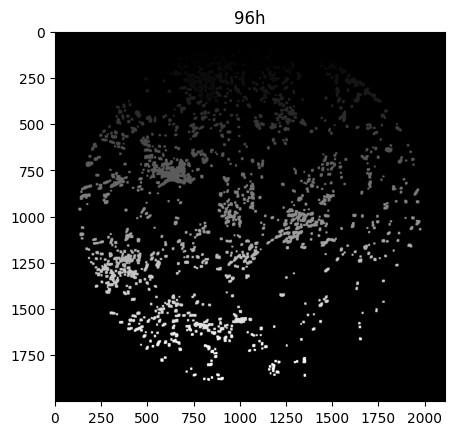

count    7.630000e+02
mean     2.394194e+03
std      5.219980e+04
min      8.100000e+01
25%      1.670000e+02
50%      2.630000e+02
75%      4.550000e+02
max      1.442038e+06
Name: area, dtype: float64
        area     perimeter   centroid-0   centroid-1  area_filled
0    1442038  14464.382536  1019.222328  1048.536802      4224000
1        296     63.798990    75.594595  1062.560811          296
2        981    159.012193    86.597350   884.301733          981
3        143     44.000000    91.000000   827.000000          143
4      11688   1261.536147   187.539014  1084.099932        11698
..       ...           ...          ...          ...          ...
758      203     53.071068  1860.541872  1349.039409          203
759      167     47.414214  1872.461078   847.532934          167
760      502     98.041631  1878.910359   895.031873          502
761      167     47.071068  1879.922156   806.053892          167
762      209     51.899495  1882.818182   829.143541          209

[763

In [ ]:
# Exemplo de uso para uma imagem de controle
labeled_image, properties = process_image('96h_treated.jpg')

# Exibir imagem segmentada
plt.imshow(labeled_image, cmap='gray')
plt.title('96h')
plt.show()

# Imprimir propriedades
import pandas as pd
df = pd.DataFrame(properties)
print(df['area'].describe())
df.to_csv('96h.csv', sep=';', decimal=',')
print(df)

In [ ]:
import plotly
import plotly.express as px
import plotly.graph_objects as go
from skimage import data, filters, measure, morphology

img = cv2.imread('29h_treated.jpg', cv2.IMREAD_GRAYSCALE)
# Binary image, post-process the binary mask and compute labels
threshold = filters.threshold_otsu(img)
mask = img > threshold
mask = morphology.remove_small_objects(mask, 50)
mask = morphology.remove_small_holes(mask, 50)
labels = measure.label(mask)

fig = px.imshow(img, binary_string=True)
fig.update_traces(hoverinfo='skip')  # hover is only for label info

props = measure.regionprops(labels, img)
properties = ['area', 'eccentricity', 'perimeter', 'intensity_mean']

# For each label, add a filled scatter trace for its contour,
# and display the properties of the label in the hover of this trace.
for index in range(1, labels.max()):
    label_i = props[index].label
    contour = measure.find_contours(labels == label_i, 0.5)[0]
    y, x = contour.T
    hoverinfo = ''
    for prop_name in properties:
        hoverinfo += f'<b>{prop_name}: {getattr(props[index], prop_name):.2f}</b><br>'
    fig.add_trace(
        go.Scatter(
            x=x,
            y=y,
            name=label_i,
            mode='lines',
            fill='toself',
            showlegend=False,
            hovertemplate=hoverinfo,
            hoveron='points+fills',
        )
    )

plotly.io.show(fig)

In [ ]:
import plotly
import plotly.express as px
import plotly.graph_objects as go
from skimage import data, filters, measure, morphology

img = cv2.imread('Normal_treated.jpg', cv2.IMREAD_GRAYSCALE)
# Binary image, post-process the binary mask and compute labels
threshold = filters.threshold_otsu(img)
mask = img > threshold
mask = morphology.remove_small_objects(mask, 50)
mask = morphology.remove_small_holes(mask, 50)
labels = measure.label(mask)

fig = px.imshow(img, binary_string=True)
fig.update_traces(hoverinfo='skip')  # hover is only for label info

props = measure.regionprops(labels, img)
properties = ['area', 'eccentricity', 'perimeter', 'intensity_mean']

# For each label, add a filled scatter trace for its contour,
# and display the properties of the label in the hover of this trace.
for index in range(1, labels.max()):
    label_i = props[index].label
    contour = measure.find_contours(labels == label_i, 0.5)[0]
    y, x = contour.T
    hoverinfo = ''
    for prop_name in properties:
        hoverinfo += f'<b>{prop_name}: {getattr(props[index], prop_name):.2f}</b><br>'
    fig.add_trace(
        go.Scatter(
            x=x,
            y=y,
            name=label_i,
            mode='lines',
            fill='toself',
            showlegend=False,
            hovertemplate=hoverinfo,
            hoveron='points+fills',
        )
    )

plotly.io.show(fig)

In [ ]:
import plotly
import plotly.express as px
import plotly.graph_objects as go
from skimage import data, filters, measure, morphology

img = cv2.imread('53h_treated.jpg', cv2.IMREAD_GRAYSCALE)
# Binary image, post-process the binary mask and compute labels
threshold = filters.threshold_otsu(img)
mask = img > threshold
mask = morphology.remove_small_objects(mask, 50)
mask = morphology.remove_small_holes(mask, 50)
labels = measure.label(mask)

fig = px.imshow(img, binary_string=True)
fig.update_traces(hoverinfo='skip')  # hover is only for label info

props = measure.regionprops(labels, img)
properties = ['area', 'eccentricity', 'perimeter', 'intensity_mean']

# For each label, add a filled scatter trace for its contour,
# and display the properties of the label in the hover of this trace.
for index in range(1, labels.max()):
    label_i = props[index].label
    contour = measure.find_contours(labels == label_i, 0.5)[0]
    y, x = contour.T
    hoverinfo = ''
    for prop_name in properties:
        hoverinfo += f'<b>{prop_name}: {getattr(props[index], prop_name):.2f}</b><br>'
    fig.add_trace(
        go.Scatter(
            x=x,
            y=y,
            name=label_i,
            mode='lines',
            fill='toself',
            showlegend=False,
            hovertemplate=hoverinfo,
            hoveron='points+fills',
        )
    )

plotly.io.show(fig)

In [ ]:
import plotly
import plotly.express as px
import plotly.graph_objects as go
from skimage import data, filters, measure, morphology

img = cv2.imread('73h_treated.jpg', cv2.IMREAD_GRAYSCALE)
# Binary image, post-process the binary mask and compute labels
threshold = filters.threshold_otsu(img)
mask = img > threshold
mask = morphology.remove_small_objects(mask, 50)
mask = morphology.remove_small_holes(mask, 50)
labels = measure.label(mask)

fig = px.imshow(img, binary_string=True)
fig.update_traces(hoverinfo='skip')  # hover is only for label info

props = measure.regionprops(labels, img)
properties = ['area', 'eccentricity', 'perimeter', 'intensity_mean']

# For each label, add a filled scatter trace for its contour,
# and display the properties of the label in the hover of this trace.
for index in range(1, labels.max()):
    label_i = props[index].label
    contour = measure.find_contours(labels == label_i, 0.5)[0]
    y, x = contour.T
    hoverinfo = ''
    for prop_name in properties:
        hoverinfo += f'<b>{prop_name}: {getattr(props[index], prop_name):.2f}</b><br>'
    fig.add_trace(
        go.Scatter(
            x=x,
            y=y,
            name=label_i,
            mode='lines',
            fill='toself',
            showlegend=False,
            hovertemplate=hoverinfo,
            hoveron='points+fills',
        )
    )

plotly.io.show(fig)

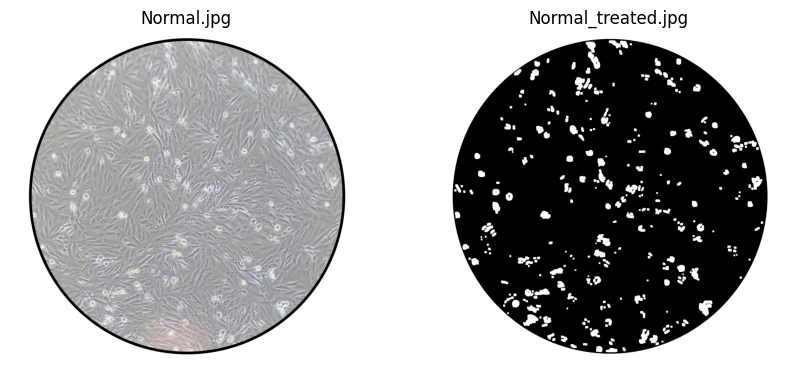

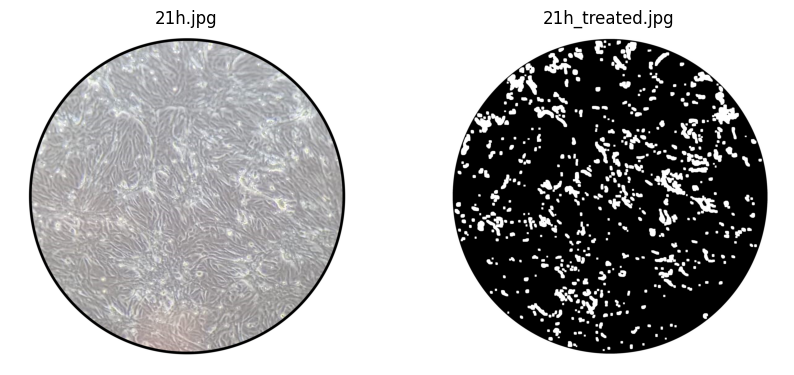

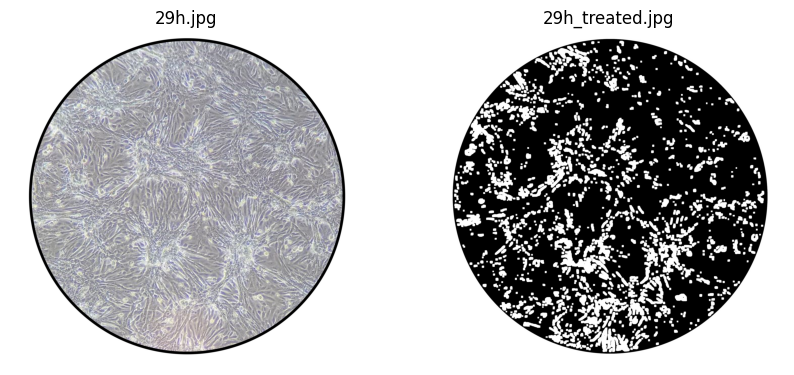

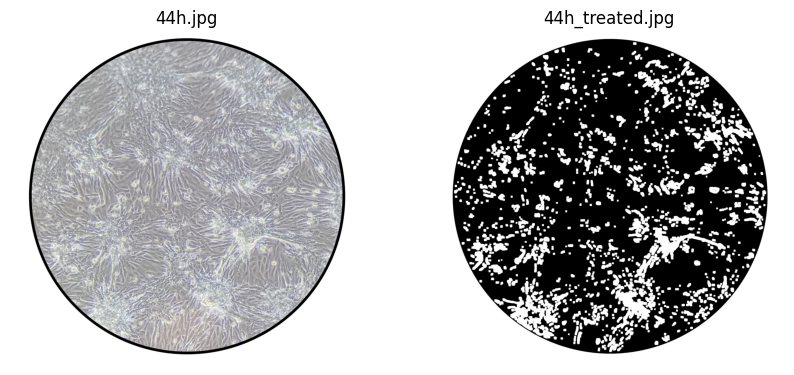

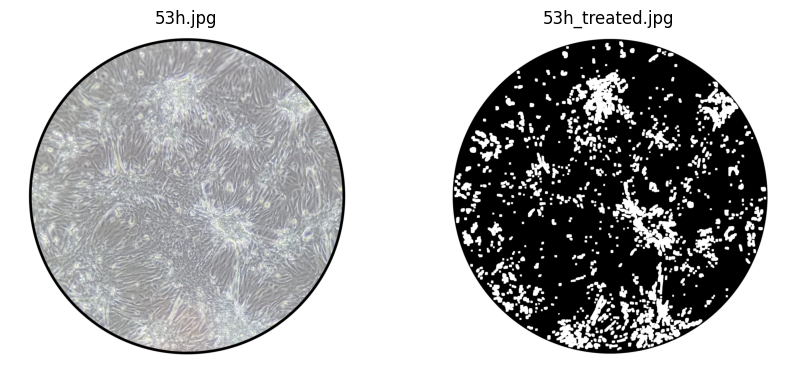

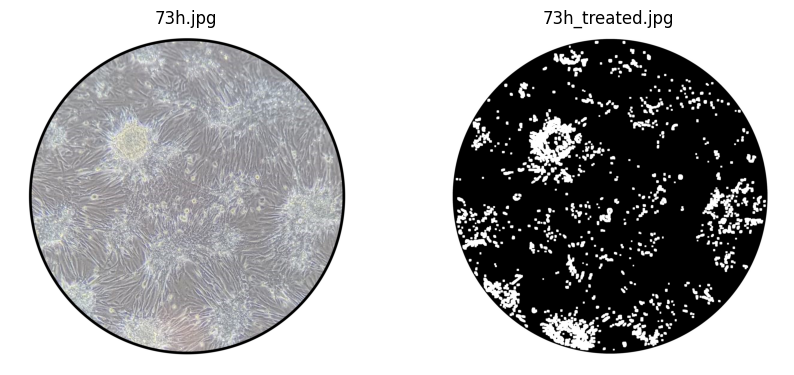

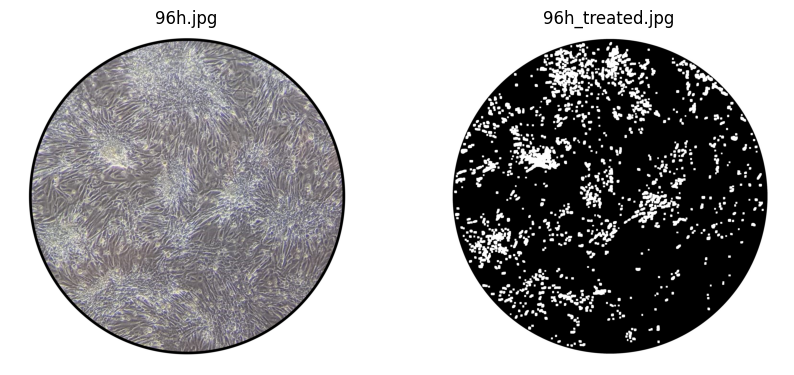

In [ ]:
import matplotlib.pyplot as plt
import cv2

def exibir_comparacao_imagens(original_path, tratada_path):
    # Carregar imagens
    original = cv2.imread(original_path)
    tratada = cv2.imread(tratada_path)

    # Configurar subplot
    plt.figure(figsize=(10, 5))

    # Plotar imagem original
    plt.subplot(1, 2, 1)
    plt.title(original_path)
    plt.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    # Plotar imagem tratada
    plt.subplot(1, 2, 2)
    plt.title(tratada_path)
    plt.imshow(cv2.cvtColor(tratada, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.show()

# Nomes dos arquivos de imagem
nomes_imagens = ['Normal', '21h', '29h', '44h', '53h', '73h', '96h']

# Exibir comparação para cada imagem
for nome in nomes_imagens:
    original_path = f"{nome}.jpg"
    tratada_path = f"{nome}_treated.jpg"
    exibir_comparacao_imagens(original_path, tratada_path)


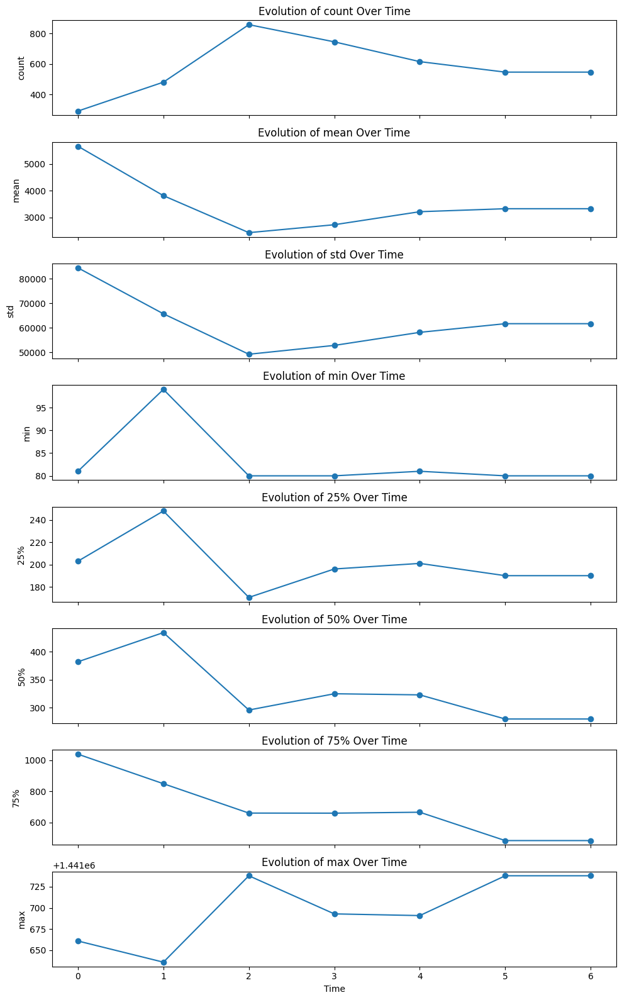

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Supondo que você tenha uma lista de dataframes, onde cada dataframe representa um momento no tempo.
# Aqui está um exemplo de como essa lista pode ser definida:

_, p1 = process_image('Normal_treated.jpg')
_, p2 = process_image('21h_treated.jpg')
_, p3 = process_image('29h_treated.jpg')
_, p4 = process_image('44h_treated.jpg')
_, p5 = process_image('53h_treated.jpg')
_, p6 = process_image('73h_treated.jpg')
_, p7 = process_image('96h_treated.jpg')

df1 = pd.DataFrame(p1)
df2 = pd.DataFrame(p2)
df3 = pd.DataFrame(p3)
df4 = pd.DataFrame(p4)
df5 = pd.DataFrame(p5)
df6 = pd.DataFrame(p6)
df7 = pd.DataFrame(p7)


dataframes = [df1, df2, df3, df4, df5, df6, df6]  # Substitua isso com seus próprios dataframes

# Lista para armazenar as estatísticas
stats_over_time = []

# Iterar sobre os dataframes e aplicar a função describe() na coluna 'area'
for df in dataframes:
    stats = df['area'].describe()
    stats_over_time.append(stats)

# Convertendo a lista de séries em um dataframe para facilitar o plot
stats_df = pd.DataFrame(stats_over_time)

# Adicionando uma coluna para o tempo (supondo que os dataframes estão em ordem temporal)
stats_df['time'] = range(len(dataframes))

# Definindo o número de subplots
num_stats = len(stats_df.columns) - 1  # menos a coluna 'time'

# Criando subplots
fig, axes = plt.subplots(nrows=num_stats, ncols=1, figsize=(10, 2 * num_stats), sharex=True)

# Plotando cada estatística em um subplot separado
for i, column in enumerate(stats_df.columns[:-1]):  # ignorando a coluna 'time'
    axes[i].plot(stats_df['time'], stats_df[column], marker='o')
    axes[i].set_ylabel(column)
    axes[i].set_title(f'Evolution of {column} Over Time')

# Adicionando rótulo do eixo x ao último subplot
axes[-1].set_xlabel('Time')

# Ajustando layout
plt.tight_layout()

# Mostrando o gráfico
plt.show()


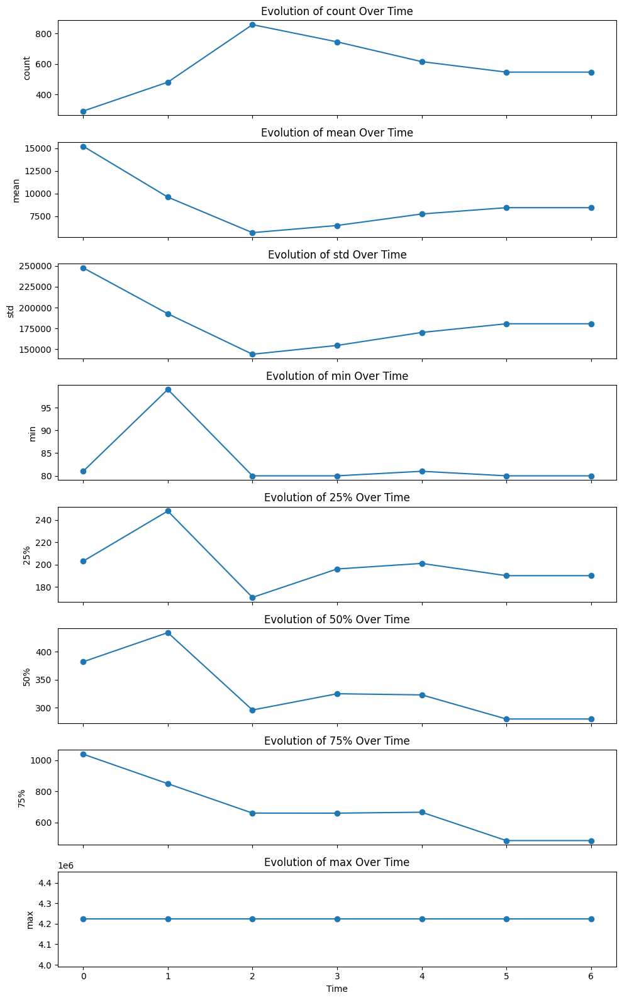

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

_, p1 = process_image('Normal_treated.jpg')
_, p2 = process_image('21h_treated.jpg')
_, p3 = process_image('29h_treated.jpg')
_, p4 = process_image('44h_treated.jpg')
_, p5 = process_image('53h_treated.jpg')
_, p6 = process_image('73h_treated.jpg')
_, p7 = process_image('96h_treated.jpg')

df1 = pd.DataFrame(p1)
df2 = pd.DataFrame(p2)
df3 = pd.DataFrame(p3)
df4 = pd.DataFrame(p4)
df5 = pd.DataFrame(p5)
df6 = pd.DataFrame(p6)
df7 = pd.DataFrame(p7)

dataframes = [df1, df2, df3, df4, df5, df6, df6]
stats_over_time = []

for df in dataframes:
    stats = df['area'].describe()
    stats_over_time.append(stats)

stats_df = pd.DataFrame(stats_over_time)
stats_df['time'] = range(len(dataframes))
num_stats = len(stats_df.columns) - 1


fig, axes = plt.subplots(nrows=num_stats, ncols=1, figsize=(10, 2 * num_stats), sharex=True)
for i, column in enumerate(stats_df.columns[:-1]):
    axes[i].plot(stats_df['time'], stats_df[column], marker='o')
    axes[i].set_ylabel(column)
    axes[i].set_title(f'Evolution of {column} Over Time')


axes[-1].set_xlabel('Time')


plt.tight_layout()
plt.show()